In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage import restoration
import pandas as pd

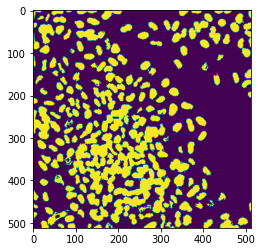

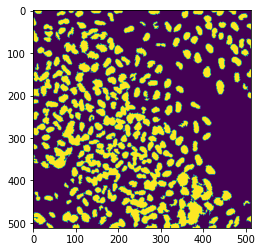

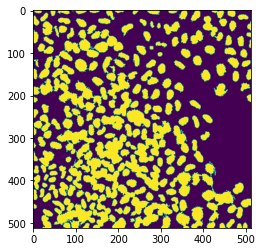

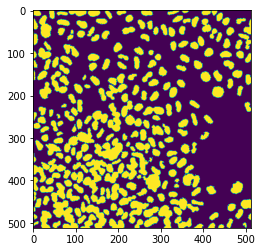

In [23]:
summary = {}
img_masks = {}
path_g = './path/to/gigafile-0316-cada71d64790dc3a8d10c5311a869123/N-gr-'
path_r = './path/to/gigafile-0316-cada71d64790dc3a8d10c5311a869123/N-rd-'

for key in ["0","1","2","3"]:
    img_g = cv2.imread(path_g+'{}.tiff'.format(key))
    img_r = cv2.imread(path_r+'{}.tiff'.format(key))

    img_g_gray = cv2.cvtColor(img_g, cv2.COLOR_BGR2GRAY)
    img_r_gray = cv2.cvtColor(img_r, cv2.COLOR_BGR2GRAY)
    
    img_g_gray = cv2.blur(img_g_gray, (2,2))
    img_r_gray = cv2.blur(img_r_gray, (2, 2))

    background_g = restoration.rolling_ball(img_g_gray, radius=50)
    background_r = restoration.rolling_ball(img_r_gray, radius=50)
    img_g_ball= img_g_gray - background_g
    img_r_ball= img_r_gray - background_r

    th_g, im_g_binry = cv2.threshold(img_g_ball, 0, 255, cv2.THRESH_OTSU)
    th_r, im_r_binry = cv2.threshold(img_r_ball, 0, 255, cv2.THRESH_OTSU)

    contours_g, hierarchy_g = cv2.findContours(im_g_binry, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours_r, hierarchy_r = cv2.findContours(im_r_binry, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours_g = list(filter(lambda x: cv2.contourArea(x) >= 50 , contours_g))
    contours_r = list(filter(lambda x: cv2.contourArea(x) >= 50 , contours_r))

    cimg_g = np.zeros_like(img_g_gray)
    cv2.drawContours(cimg_g, contours_g, -1, color=255, thickness=-1)
    cimg_r = np.zeros_like(img_r_gray)
    cv2.drawContours(cimg_r, contours_r, -1, color=255, thickness=-1)
    cimg_w = cv2.bitwise_or(cimg_g, cimg_r)
    contours_w, hierarchy_w = cv2.findContours(cimg_w, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contours_w = list(filter(lambda x: cv2.contourArea(x) >= 80 , contours_w))

    
    img_result = cv2.drawContours(cimg_w, contours_w, -1, color=(255, 255,255),thickness=1)
    img_masks[key] = img_result
    plt.imshow(img_result)
    plt.show()

    lst_intensities = []
    for i in range(len(contours_w)):
        # Create a mask image that contains the contour filled in
        cimg_c = np.zeros_like(img_g_gray)
        cv2.drawContours(cimg_c, contours_w, i, color=255, thickness=-1)
        # Access the image pixels and create a 1D numpy array then add to list
        pts = np.where(cimg_c == 255)
        M = cv2.moments(contours_w[i])
        cx = int(M['m10']/M['m00'])
        cy = int(M['m01']/M['m00'])
        size =  cv2.contourArea(contours_w[i])
        green_int = img_g_ball[pts[0], pts[1]]
        red_int = img_r_ball[pts[0], pts[1]]
        lst_intensities.append([cx, cy, size, np.mean(green_int), np.mean(red_int), np.sum(green_int), np.sum(red_int)]) # [Green, Red]
    df = pd.DataFrame(lst_intensities,columns = ["X","Y","Size","Mean_Gr","Mean_Rd","Sum_Gr","Sum_Rd"])
    summary[key] = df

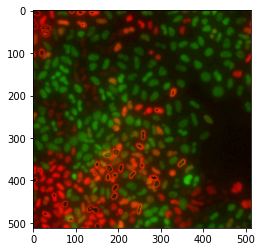

In [44]:
size =(512,512)
black = np.zeros(size,np.uint8)
plt.imshow(cv2.merge((img_r_gray*10, img_g_gray*10,black)))


In [ ]:
plt.imshow(cv2.merge((np.zeros((512,512)),img_g_gray,img_r_gray)))
plt.show()

In [ ]:
# Rotation Invariant Phase Only Correlation (RIPOC)
timeser = ["0","1","2","3"]
context = {}
imgs = {}
for n in range(len(timeser)):
    if n == len(timeser)-1: break
    ref_img_gray = np.array(img_masks[timeser[n]],dtype=np.float64)
    tgt_img_gray = np.array(img_masks[timeser[n+1]],dtype=np.float64)

    h, w = ref_img_gray.shape
    center = (w/2, h/2)
    hunning_y = np.hanning(h)
    hunning_x = np.hanning(h)
    hunning_w = hunning_y.reshape(h, 1)*hunning_x
    ref_img_fft = np.fft.fftshift(np.log(np.abs(np.fft.fft2(ref_img_gray*hunning_w))))
    tgt_img_fft = np.fft.fftshift(np.log(np.abs(np.fft.fft2(tgt_img_gray*hunning_w))))
    l = np.sqrt(w*w + h*h)
    m = l/np.log(l)
    flags = cv2.INTER_LANCZOS4 + cv2.WARP_POLAR_LOG
    ref_img_pol = cv2.warpPolar(ref_img_fft, (w, h), center, m, flags)
    tgt_img_pol = cv2.warpPolar(tgt_img_fft, (w, h), center, m, flags)

    (x1, y1), response = cv2.phaseCorrelate(ref_img_pol, tgt_img_pol, hunning_w)
    angle = y1*360/h
    scale = 1 #(np.e)**(x1/m)
    print(f'angle: {angle}\nscale: {scale}')
    M = cv2.getRotationMatrix2D(center, angle, scale)
    
    tgt_img_affine = cv2.warpAffine((tgt_img_gray), M, (w, h))
    
    (x, y), response = cv2.phaseCorrelate(ref_img_gray, tgt_img_affine)
    print(f'x: {x}\ny: {y}')
    M = np.float32([[1, 0, -x], [0, 1, -y]])
    aligned_img= cv2.warpAffine(tgt_img_affine, M, (w, h))
    fig, axes = plt.subplots(1, 3, tight_layout=True,figsize=(10,4))
    axes[0].imshow(ref_img_gray)
    axes[1].imshow(tgt_img_gray)
    axes[2].imshow(aligned_img)
    if n == 0:
        imgs[str(n)] = ref_img_gray
    
    imgs[str(n+1)] = tgt_img_gray#aligned_img
    plt.show()
    
    alighned_pos = {}
    for idx in summary[timeser[n+1]].index:
        alighned_pos[idx] = {}
        point = [summary[timeser[n+1]].loc[idx, "X"], summary[timeser[n+1]].loc[idx, "Y"]]
        point = rotate_point(point,center,angle)
        alighned_pos[idx]["X"] = point[0] + x
        alighned_pos[idx]["Y"] = point[1] + y
        
    context[timeser[n]+"_"+timeser[n+1]] = []
    for idx_ref in summary[timeser[n]].index:
        min_dist = 1000
        closest = ""
        dist_th = 18
        for idx_tgt in alighned_pos.keys():
            x_ref, y_ref = summary[timeser[n]].loc[idx_ref,"X"], summary[timeser[n]].loc[idx_ref,"Y"],
            x_tgt, y_tgt = alighned_pos[idx_tgt]["X"], alighned_pos[idx_tgt]["Y"]
            curr_dist = np.sqrt((x_tgt-x_ref)**2+(y_tgt-y_ref)**2)
            if curr_dist < dist_th:
                if curr_dist < min_dist:
                    closest = idx_tgt
                    min_dist = curr_dist
        else:
            if min_dist == 1000:
                context[timeser[n]+"_"+timeser[n+1]].append(str(idx_ref)+"_"+"None")
            else:
                context[timeser[n]+"_"+timeser[n+1]].append(str(idx_ref)+"_"+str(closest))


In [ ]:
objs = []
for idx in summary["0"].index:
    if (summary["0"].loc[idx,"Sum_Gr"]>150) and (summary["0"].loc[idx,"Sum_Gr"]<250) :
        if (summary["0"].loc[idx,"Sum_Rd"]>400) and (summary["0"].loc[idx,"Sum_Rd"]<2000) :
            objs.append(idx)
            
ser = ["0","1","2","3","4"]
width = 10
hight = 10
for obj in objs[:]:
    OB = obj
    fig,axes = plt.subplots(5)
    for n,key in enumerate(ser[1:]):#,"1","2","3","4"]:
        max_h = imgs[key].shape[0]
        max_w = imgs[key].shape[1]
        trim_x_min = max(0, summary[key].loc[OB,"X"]-width)
        trim_x_max = min(max_w, summary[key].loc[OB,"X"]+width)
        trim_y_min = max(0, summary[key].loc[OB,"Y"]-width)
        trim_y_max = min(max_h, summary[key].loc[OB,"Y"]+width)
        cropped_image = imgs[key][trim_y_min:trim_y_max, trim_x_min:trim_x_max]
        cropped_image = cv2.cvtColor(cropped_image.astype(np.uint8), cv2.COLOR_GRAY2BGR)
        if n == 0:
            axes[0].imshow(cropped_image)
        trim_x_min_nx = max(0, trim_x_min-search_width)
        trim_x_max_nx = min(max_w, trim_x_max+search_width)
        trim_y_min_nx = max(0, trim_y_min-search_width)
        trim_y_max_nx = min(max_h, trim_y_max+search_width)
        cropped_image_next =  imgs[ser[n+1]][trim_y_min_nx+Y:trim_y_max_nx, trim_x_min_nx:trim_x_max_nx]
        cropped_image_next = cv2.cvtColor(cropped_image_next.astype(np.uint8), cv2.COLOR_GRAY2BGR)
        method = cv2.TM_CCOEFF_NORMED     
        res = cv2.matchTemplate(cropped_image_next, cropped_image, method)
        min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(res)
        cropped_image_next_trim = cropped_image_next[
                                                                                                 max_loc[1]:max_loc[1]+cropped_image.shape[1],
                                                                                                max_loc[0]:max_loc[0]+cropped_image.shape[0]]
    
        #imgs[ser[n+1]][trim_y_min_nx+max_loc[0]:trim_y_max+max_loc[0], 
        #                                     trim_x_min+max_loc[1]:trim_x_max+max_loc[1]]
        axes[n+1].imshow(cropped_image_next_trim)
    plt.show()
    print(trim_x_min_nx+max_loc[0]+(cropped_image.shape[0])*1/2,
                  trim_y_min_nx+max_loc[1]+(cropped_image.shape[1])*1/2)
        

In [164]:
temp_conn =["0_1","1_2","2_3"]#,"3_4"]
timeseries = []
for t0 in context["0_1"]:
    t_f, t_l = t0.split("_")
    series = [t_f, t_l]
    
    if t_l == None: continue
    for t_later in temp_conn[1:]:
        for pair in context[t_later]:
            if t_l == pair.split("_")[0]:
                series.append(pair.split("_")[1])
                t_l = pair.split("_")[1]
                break
    else:
        timeseries.append(series)
timeseries = [t for t in timeseries if (len(t)==5)&(t[-1]!="None")]
len(timeseries)

0

In [147]:
locates = {}
for i in range(len(timeseries)):
    print(i)
    fig = plt.figure()
    ax = plt.subplot(111)
    summary["0"]["TP"] = 0
    summary["1"]["TP"] = 1
    summary["2"]["TP"] = 2
    summary["3"]["TP"] = 3
    #summary["4"]["TP"] = 4
    cat = pd.concat([summary["0"], summary["1"], summary["2"], summary["3"], summary["4"]])
    cat.plot(kind="scatter",x="Sum_Gr",y="Sum_Rd", loglog=True,figsize=(4,4),ax=ax,s=4)
    tps = [0,1,2,3,4]
    plt.xlim(10,10000)
    plt.ylim(10,10000)
    tp = 0
    locates[i] = []
    for ts in [timeseries[i]]:
        print(ts)
        for n,t in enumerate(ts):
            if n==4:
                locates[i].append([cat_tp_next.loc[int(ts[n]),"X"], cat_tp_next.loc[int(ts[n]),"Y"]])
                break
            cat_tp = cat[cat["TP"]==tps[n]]
            cat_tp_next = cat[cat["TP"]==tps[n+1]]
            #ax.plot([cat_tp.loc[int(ts[n]),"Sum_Gr"], cat_tp.loc[int(ts[n]),"Sum_Rd"]],
             #            [cat_tp_next.loc[int(ts[n+1]),"Sum_Gr"], cat_tp_next.loc[int(ts[n+1]),"Sum_Rd"]])
            ax.plot([cat_tp.loc[int(ts[n]),"Sum_Gr"], cat_tp_next.loc[int(ts[n+1]),"Sum_Gr"]],
                         [cat_tp.loc[int(ts[n]),"Sum_Rd"], cat_tp_next.loc[int(ts[n+1]),"Sum_Rd"]], 
                    color="k")
            if n == 0:
                s = 40
                c="k"
            else:
                s = 25
                c="r"
        
            ax.scatter([cat_tp.loc[int(ts[n]),"Sum_Gr"], cat_tp_next.loc[int(ts[n+1]),"Sum_Gr"]],[cat_tp.loc[int(ts[n]),"Sum_Rd"], cat_tp_next.loc[int(ts[n+1]),"Sum_Rd"]],
                      s=s,c=c)
            locates[i].append([cat_tp.loc[int(ts[n]),"X"], cat_tp.loc[int(ts[n]),"Y"]])
    plt.show()


In [148]:
import plotly as pl
import plotly.express as px
import plotly.graph_objects as go

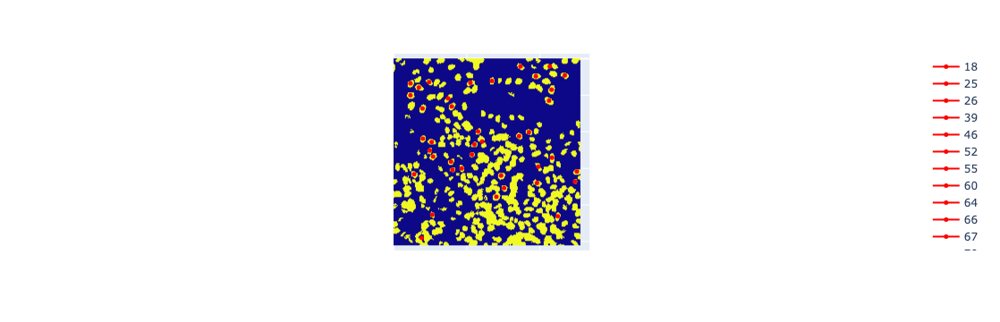

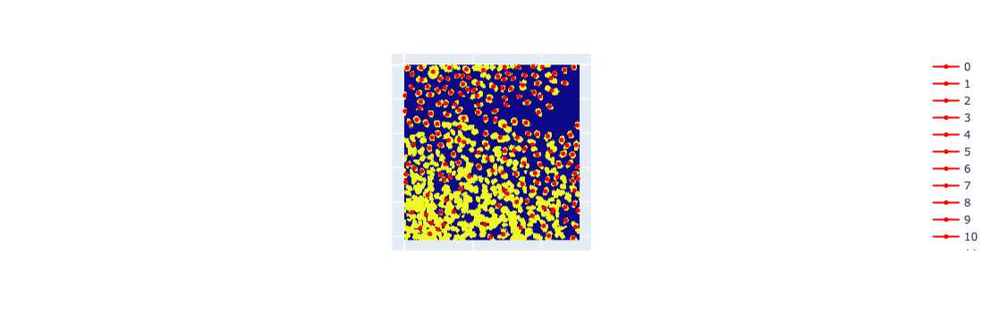

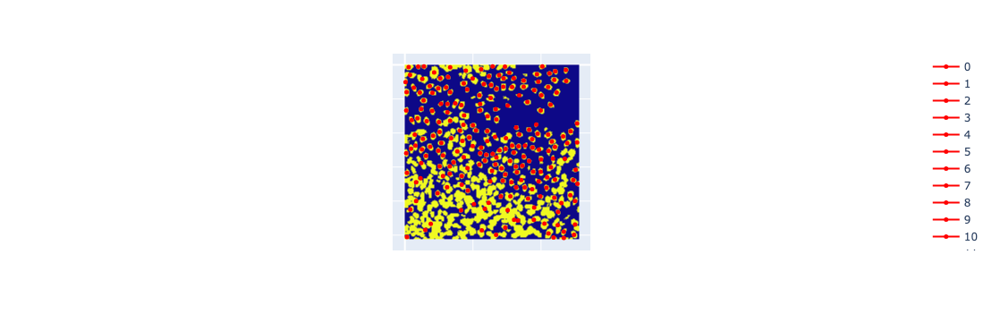

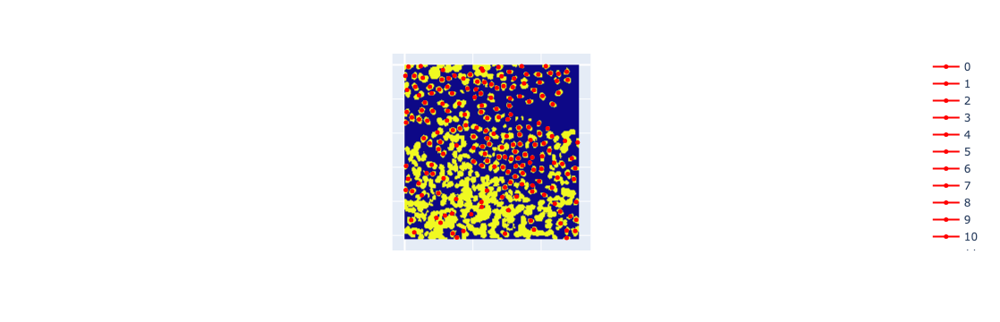

In [171]:
for key in ["0","1","2","3"]:
    fig = px.imshow(imgs[key])
    for idx in summary[key].index:
        if (key =="0") and (summary[key].loc[idx,"Sum_Gr"]>200) and (summary[key].loc[idx,"Sum_Gr"]<500) :#150,400
            if (key =="0") and (summary[key].loc[idx,"Sum_Rd"]>400) and (summary[key].loc[idx,"Sum_Rd"]<4000) : #400,3000
                fig.add_trace(go.Scatter(x=[summary[key].loc[idx,"X"]], y=[summary[key].loc[idx,"Y"]], 
                                         marker=dict(color='red', size=5), name=str(idx)))

                                         #marker=dict(color='red', size=5), name=str(summary[key].loc[idx,"Sum_Gr"])+"_"+str(summary[key].loc[idx,"Sum_Rd"])))
        elif key !="0":
            fig.add_trace(go.Scatter(x=[summary[key].loc[idx,"X"]], y=[summary[key].loc[idx,"Y"]], 
                                         marker=dict(color='red', size=5), name=str(idx)))
                                     #marker=dict(color='red', size=5), name=str(summary[key].loc[idx,"Sum_Gr"])+"_"+str(summary[key].loc[idx,"Sum_Rd"])))
    #fig.add_scatter(summary[key], x="X", y="Y", text="X", size_max=60)


    fig.update_layout(coloraxis_showscale=False)
    fig.update_xaxes(showticklabels=False)
    fig.update_yaxes(showticklabels=False)

    fig.show()
    #plt.scatter(locates[obj][int(key)][0], locates[obj][int(key)][1],c="w",s=10)
    #plt.show()
    
